# 실험 내용:


## grand_challenge의 lung CT데이터를 가지고 image segmentation을 해보았습니다.4명중 1명의 환자 CT 에만 정답 레이블(mask)가 있고 나머지 3명의 환자 Dataset에는 정답 레이 블이 없습니다.그러므로 첫번째 실험은 정답레이블이 있는 환자의 dataset을 가지고 lung segmentation을 해보았습니다.
## 1. grand_challenge lungCT 데이터를 읽어옵니다.
## 첫번째는 정답레이블이있는 환자의 lungCT와 mask를 읽어옵니다.

In [1]:
import cv2
import os
import skimage.io as io
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split
%matplotlib inline


SEED=42
imgs = io.imread('C://lumic_grandchell_dataset//train//020_train_pre_contrast_6mm.mhd', plugin='simpleitk')
masks = io.imread('C://lumic_grandchell_dataset//train//train_mask.mhd', plugin='simpleitk')
test_imgs = io.imread('C://lumic_grandchell_dataset//test//test_post_contrast.mhd', plugin='simpleitk')
mmasks = io.imread('C://lumic_grandchell_dataset//test//test_mask.mhd', plugin='simpleitk')

In [2]:
x_train=[]
y_train=[]
x_test = []
y_test =[]
x_val=[]
y_val=[]


#기존 영상의 크기는 512x512 영상의료이미지입니다.이미지를 줄이기 위해서 resize함수를 씁니다. 
x_train = [cv2.resize(img, dsize=(128,128),interpolation=cv2.INTER_LANCZOS4) for img in imgs]
y_train = [cv2.resize(mask, dsize=(128,128),interpolation=cv2.INTER_LANCZOS4) for mask in masks]
x_test = [cv2.resize(test_img, dsize=(128,128),interpolation=cv2.INTER_LANCZOS4) for test_img in test_imgs]
y_test =[cv2.resize(mmask, dsize=(128,128),interpolation=cv2.INTER_LANCZOS4) for mmask in mmasks]


x_train = np.array(x_train, dtype=np.float32)
y_train = np.array(y_train, dtype=np.float32)
x_test=np.array(x_test,dtype=np.float32)
y_test=np.array(y_test,dtype=np.float32)


print(x_train.shape,y_train.shape,x_test.shape,y_test.shape)


#검증하기위해 모든 학습데이터의 20%를  검증데이터로 주었습니다.
x_train,x_val,y_train,y_val = train_test_split(x_train, y_train, test_size =0.2)

x_val = np.array(x_val)
y_val = np.array(y_val)


print(x_train.shape,y_train.shape,x_test.shape,y_test.shape,x_val.shape,y_val.shape)


(286, 128, 128) (286, 128, 128) (286, 128, 128) (286, 128, 128)
(228, 128, 128) (228, 128, 128) (286, 128, 128) (286, 128, 128) (58, 128, 128) (58, 128, 128)


## 2.정답레이블이 있는 환자의 lungCT 영상과 마스크 이미지를 보여줍니다.

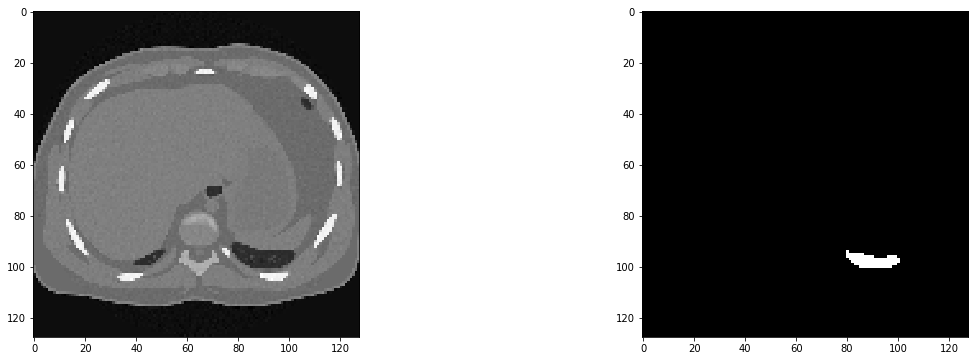

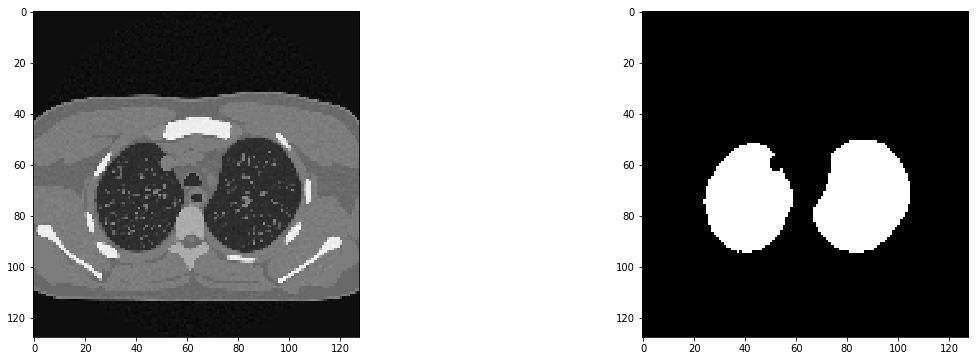

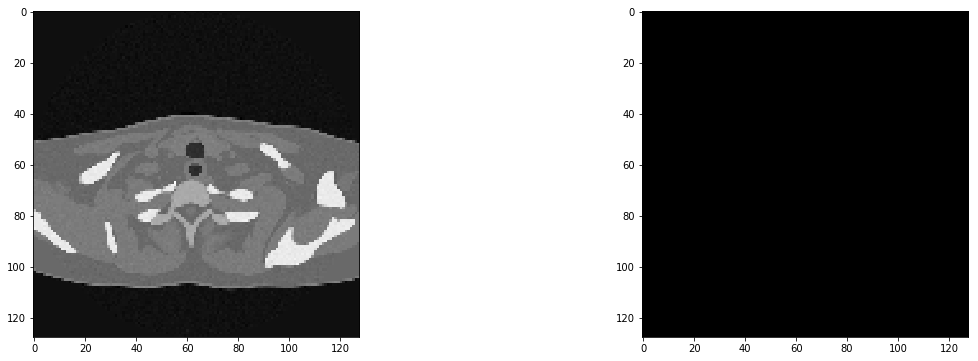

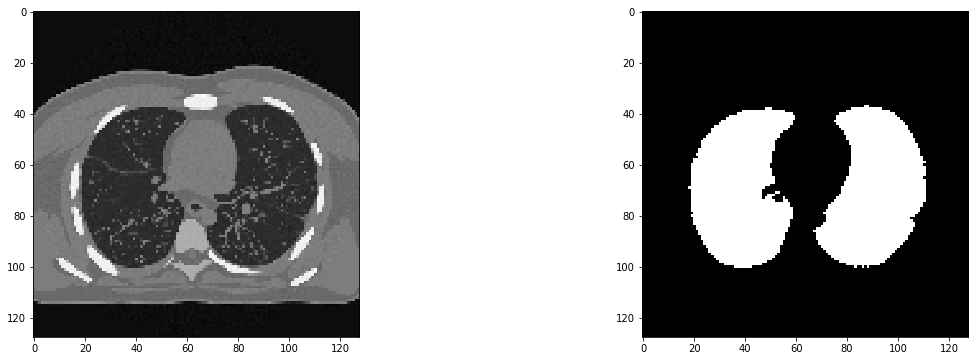

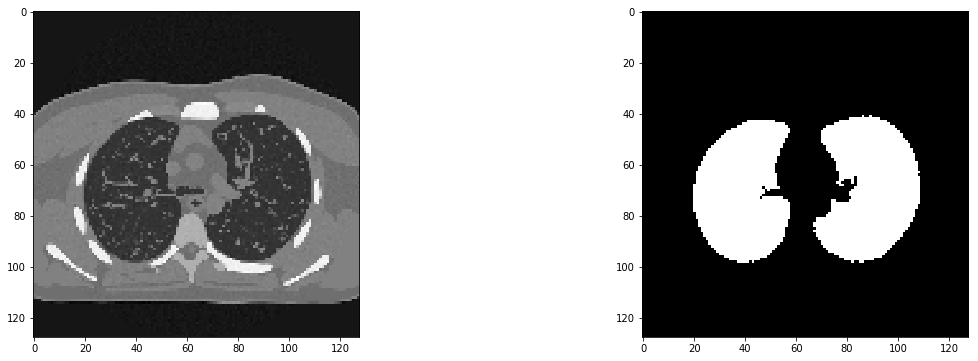

...

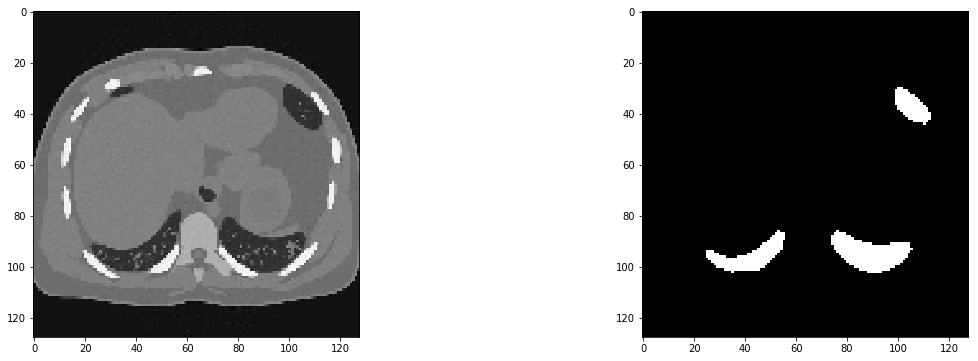

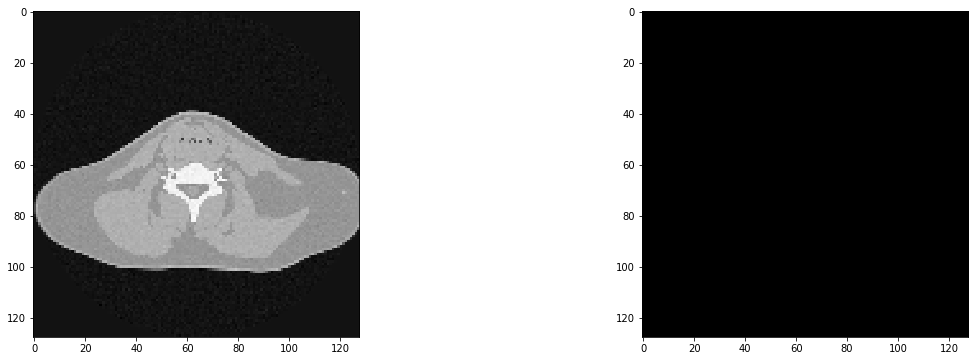

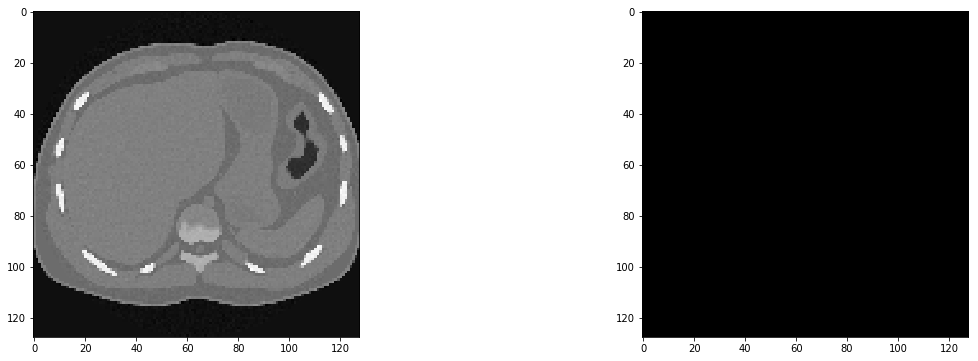

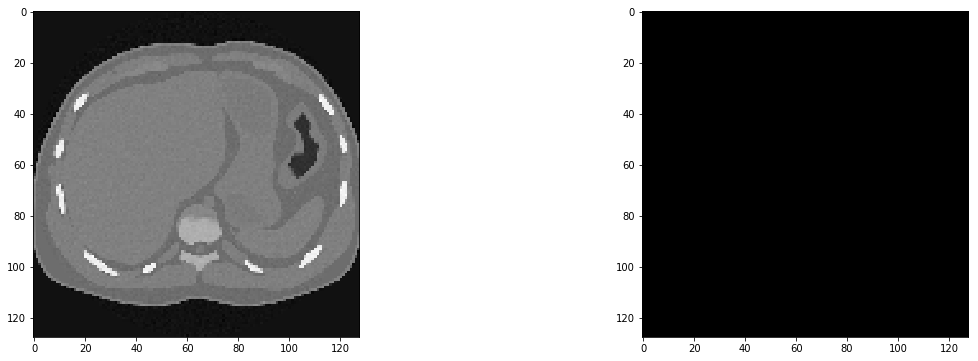

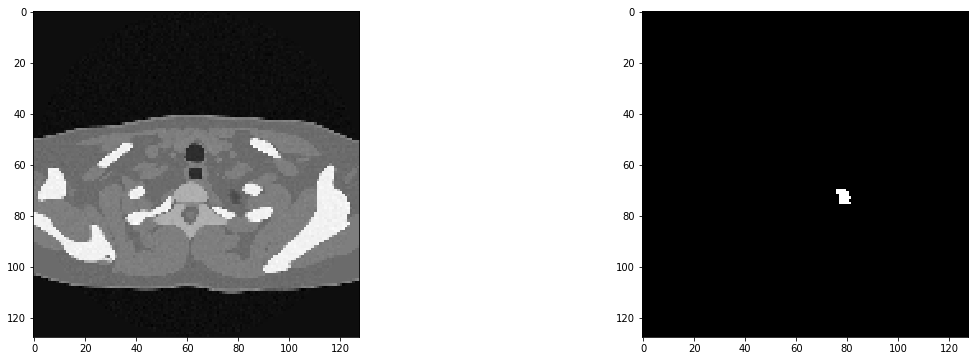

In [3]:
%matplotlib inline
import matplotlib.pyplot as plt

for i in range(0,x_train.shape[0],10):
    plt.figure(figsize=(20, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(x_train[i],'gray')
    plt.subplot(1, 2, 2)
    plt.imshow(y_train[i],'gray')    
    plt.show()

## 3.의료데이터셋은 일반 이미지와 다른 밝기 값을 가지므로 의료데이터셋에 전처리,스케일링을 적용해줍니다.

In [4]:
x_train = x_train.astype('float32')
x_test =x_test.astype('float32')
x_val=x_val.astype('float32')


center = -400
width = 1500

low = center - width / 2
high = center + width / 2


x_train = (x_train-low) / (high-low)
x_train[x_train < 0.] = 0.
x_train[x_train > 1.] = 1.

x_val = (x_val-low) / (high-low)
x_val[x_val < 0.] = 0.
x_val[x_val > 1.] = 1.

x_test = (x_test-low) / (high-low)
x_test[x_test < 0.] = 0.
x_test[x_test > 1.] = 1.


train_std = np.std(x_train)
train_mean = np.mean(x_train)
test_std = np.std(x_test)
test_mean = np.mean(x_test)
val_std = np.std(x_val)
val_mean = np.mean(x_val)
print(train_mean,train_std,test_mean,test_std,val_std,val_mean)

x_train -= train_mean
x_train /= train_std
x_test -= test_mean
x_test /= test_std
x_val -= val_mean
x_val /= val_std




y_train[y_train < 0.] = 0.
y_train[y_train > 1.] = 1.

y_val[y_val < 0.] = 0.
y_val[y_val > 1.] = 1.

y_test[y_test < 0.] = 0.
y_test[y_test > 1.] = 1.

0.47576246 0.32586575 0.4810989 0.33395082 0.3263725 0.4623209


## 4.전처리전과 전처리후의 이미지를 눈으로 쉽게 비교하기위해서 전처리 전의 이미지와 전처리후 이미지를 저장하였습니다.

In [5]:
before=np.load('C:/lumic_grandchell_dataset/beforescailing/before.npy')

after=np.load('C:/lumic_grandchell_dataset/beforescailing/after.npy')

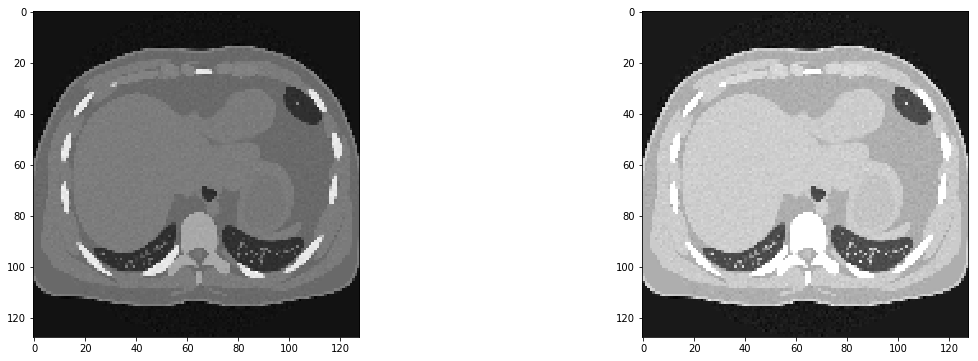

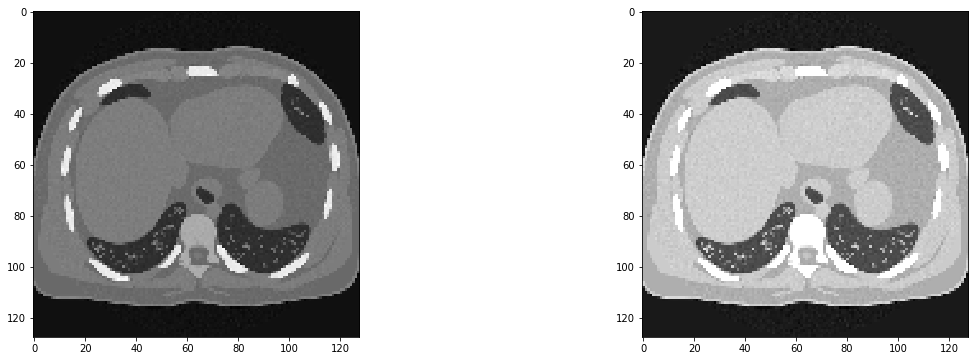

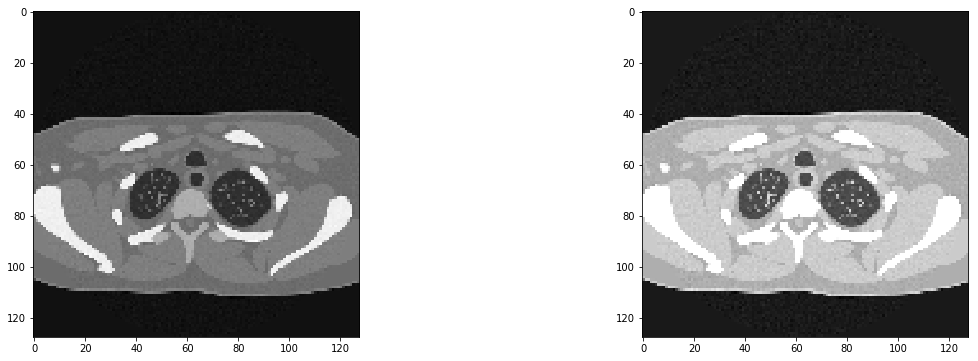

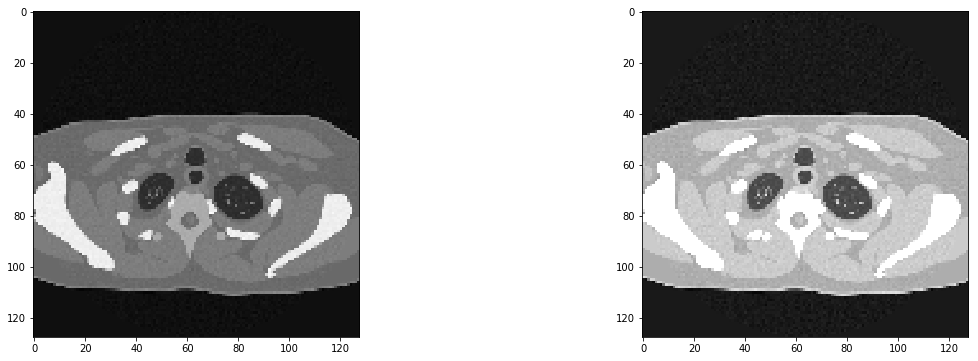

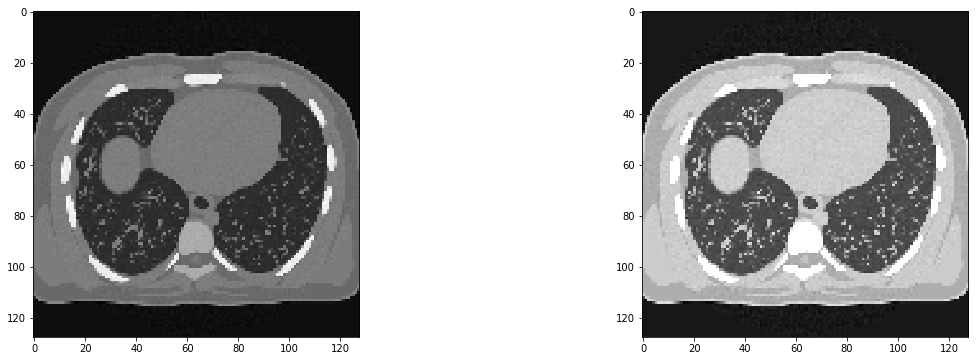

...

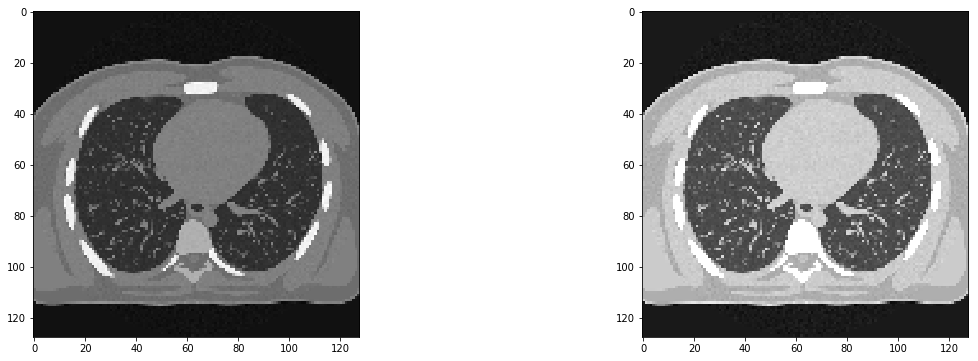

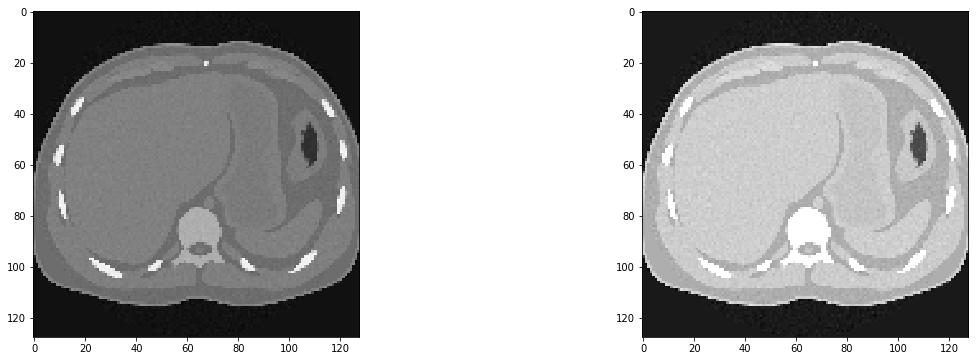

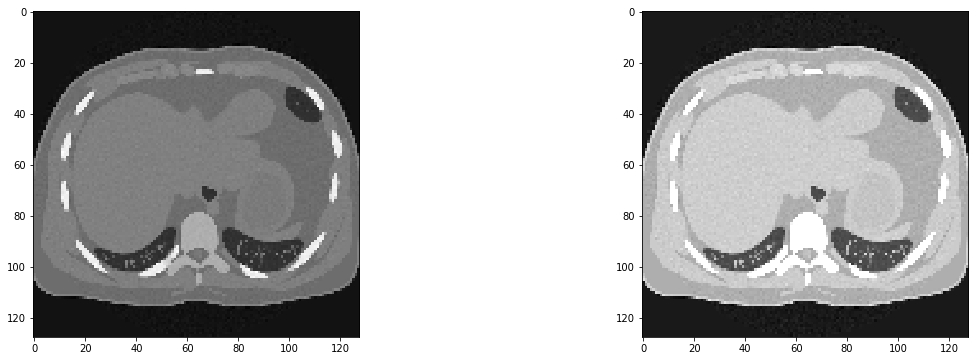

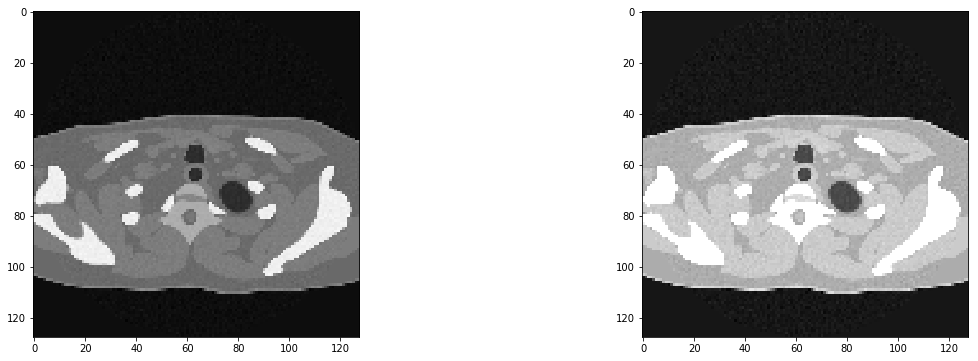

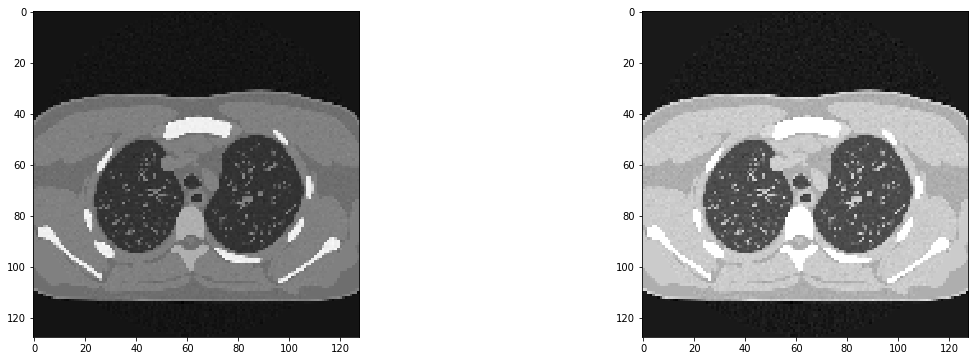

In [6]:
#왼쪽이 전처리전, 오른쪽이 전처리 후 입니다.

%matplotlib inline
import matplotlib.pyplot as plt

for i in range(0,x_train.shape[0],10):
    plt.figure(figsize=(20, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(before[i],'gray')
    plt.subplot(1, 2, 2)
    plt.imshow(after[i],'gray')    
    plt.show()

## 5.model
## 모델은 U-net을 사용했습니다. U-net은 이미지의 특정 영역을 표현하는 image segmentation에 주된 목적이 있는 모델입니다.

In [7]:
from keras.models import Model
from keras.layers import *
from keras.optimizers import Adam
from keras.regularizers import l2
from keras.preprocessing.image import ImageDataGenerator
import keras.backend as K
from keras.callbacks import LearningRateScheduler, ModelCheckpoint

input_layer = Input((128,128, 1))
c1 = Conv2D(filters=8, kernel_size=(3,3), activation='relu', padding='same')(input_layer)
l = MaxPool2D(strides=(2,2))(c1)
c2 = Conv2D(filters=16, kernel_size=(3,3), activation='relu', padding='same')(l)
l = MaxPool2D(strides=(2,2))(c2)
c3 = Conv2D(filters=32, kernel_size=(3,3), activation='relu', padding='same')(l)
l = MaxPool2D(strides=(2,2))(c3)
c4 = Conv2D(filters=32, kernel_size=(1,1), activation='relu', padding='same')(l)
l = concatenate([UpSampling2D(size=(2,2))(c4), c3], axis=-1)
l = Conv2D(filters=32, kernel_size=(2,2), activation='relu', padding='same')(l)
l = concatenate([UpSampling2D(size=(2,2))(l), c2], axis=-1)
l = Conv2D(filters=24, kernel_size=(2,2), activation='relu', padding='same')(l)
l = concatenate([UpSampling2D(size=(2,2))(l), c1], axis=-1)
l = Conv2D(filters=16, kernel_size=(2,2), activation='relu', padding='same')(l)
l = Conv2D(filters=64, kernel_size=(1,1), activation='relu')(l)
l = Dropout(0.5)(l)
output_layer = Conv2D(filters=1, kernel_size=(1,1), activation='sigmoid')(l)
                                                         
model = Model(input_layer, output_layer)

Using TensorFlow backend.


## 6.ImageDataGenerator를 사용하여 더 많은 데이터를 확보하였습니다.

In [9]:
def my_generator(x_train, y_train, batch_size):
    data_generator = ImageDataGenerator(
            width_shift_range=0.1,
            height_shift_range=0.1,
            rotation_range=10,
            zoom_range=0.1).flow(x_train, x_train, batch_size, seed=SEED)
    mask_generator = ImageDataGenerator(
            width_shift_range=0.1,
            height_shift_range=0.1,
            rotation_range=10,
            zoom_range=0.1).flow(y_train, y_train, batch_size, seed=SEED)
    while True:
        x_batch, _ = data_generator.next()
        y_batch, _ = mask_generator.next()
        yield x_batch, y_batch

In [10]:
x_train = x_train.reshape(-1,128,128,1)
y_train = y_train.reshape(-1,128,128,1)

x_test = x_test.reshape(-1,128,128,1)
y_test = y_test.reshape(-1,128,128,1)
x_val = x_val.reshape(-1,128,128,1)
y_val  = y_val.reshape(-1,128,128,1)

In [11]:
image_batch, mask_batch = next(my_generator(x_train, y_train, 3))

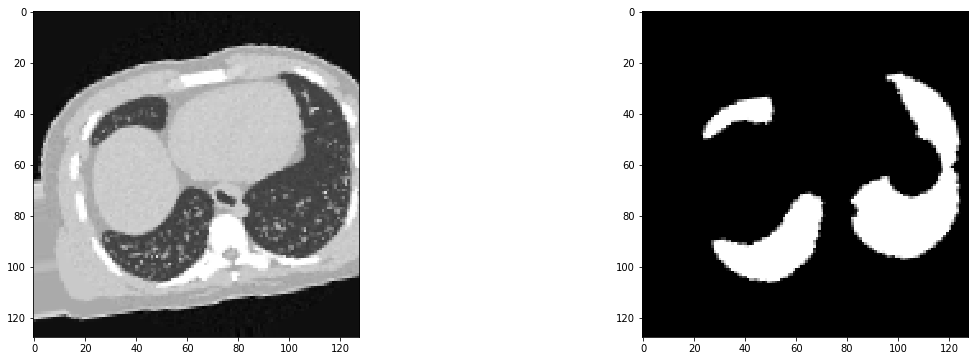

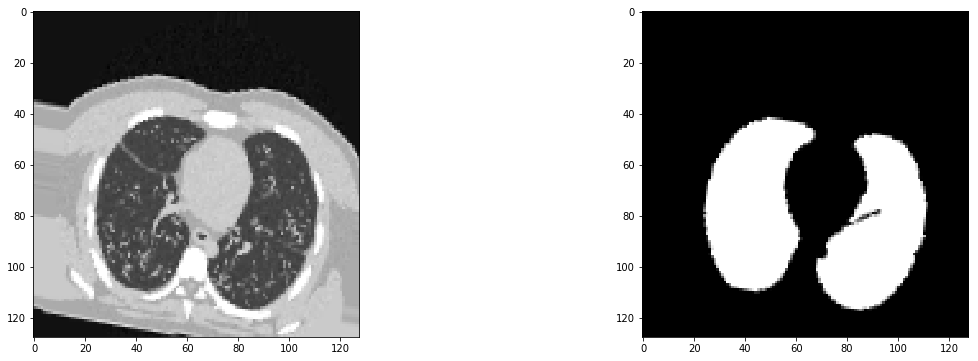

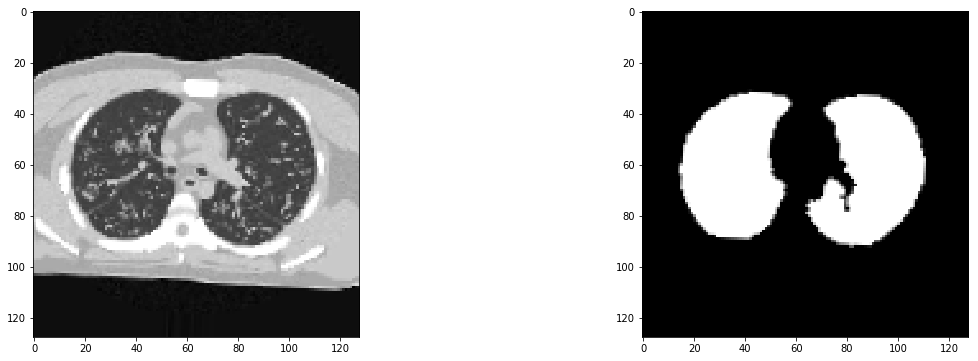

In [12]:
#왼쪽이 Data Augmentation전  Data Augmentation후입니다.

%matplotlib inline
import matplotlib.pyplot as plt

for i in range(len(image_batch)):
    plt.figure(figsize=(20, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(image_batch[i,:,:,0],'gray')
    plt.subplot(1, 2, 2)
    plt.imshow(mask_batch[i,:,:,0],'gray')    
    plt.show()

## 7.실제 정답레이블과 예측해서 만든 레이블의 정확도를 측정하기 위해 dice_coef의 함수를 정의해줍니다.

In [13]:
def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + K.epsilon()) / (K.sum(y_true_f) + K.sum(y_pred_f) + K.epsilon())

In [14]:
# 이때 loss 함수를 binary_crossentropy를 사용한 이유는 이미지의 픽셀값 0과 1을 구분하기 위해서 사용하였습니다.
model.compile(optimizer=Adam(2e-4), loss='binary_crossentropy', metrics=[dice_coef])

In [15]:
weight_saver = ModelCheckpoint('C:/lumic_grandchell_dataset/weightlung13.h5', monitor='val_dice_coef', 
                                              save_best_only=True, save_weights_only=True)
annealer = LearningRateScheduler(lambda x: 1e-3 * 0.8 ** x)

In [16]:
hist = model.fit_generator(my_generator(x_train, y_train, 1),
                           steps_per_epoch = 200,
                           validation_data = (x_val, y_val),
                           epochs=10, verbose=2,
                           callbacks = [weight_saver, annealer])

Epoch 1/10
 - 24s - loss: 0.1389 - dice_coef: 0.4655 - val_loss: 0.0339 - val_dice_coef: 0.6606
Epoch 2/10
 - 23s - loss: 0.0366 - dice_coef: 0.6302 - val_loss: 0.0265 - val_dice_coef: 0.6730
Epoch 3/10
 - 23s - loss: 0.0312 - dice_coef: 0.6468 - val_loss: 0.0259 - val_dice_coef: 0.6793
Epoch 4/10
 - 22s - loss: 0.0268 - dice_coef: 0.6243 - val_loss: 0.0240 - val_dice_coef: 0.6804
Epoch 5/10
 - 22s - loss: 0.0272 - dice_coef: 0.6521 - val_loss: 0.0239 - val_dice_coef: 0.6866
Epoch 6/10
 - 23s - loss: 0.0265 - dice_coef: 0.6589 - val_loss: 0.0223 - val_dice_coef: 0.6864
Epoch 7/10
 - 24s - loss: 0.0270 - dice_coef: 0.6508 - val_loss: 0.0215 - val_dice_coef: 0.6847
Epoch 8/10
 - 22s - loss: 0.0237 - dice_coef: 0.6395 - val_loss: 0.0232 - val_dice_coef: 0.6859
Epoch 9/10
 - 22s - loss: 0.0256 - dice_coef: 0.6657 - val_loss: 0.0219 - val_dice_coef: 0.6884
Epoch 10/10
 - 22s - loss: 0.0219 - dice_coef: 0.6560 - val_loss: 0.0209 - val_dice_coef: 0.6888


# 여기서부터는 2번째 실험입니다.
## 2번째 실험에서는 정답레이블이 없는 3개의 CT를 예측하여 임의의 정답 레이블로 만들어주었습니다.


 ## 1.정답레이블이 없는 3개의 CT를 읽어옵니다

In [17]:
imgs = io.imread('C://lumic_grandchell_dataset//train//030_train_pre_contrast_17mm.mhd', plugin='simpleitk')
a_imgs = io.imread('C://lumic_grandchell_dataset//train//010_train_pre_contrast_2mm.mhd', plugin='simpleitk')
b_imgs = io.imread('C://lumic_grandchell_dataset//train//train_post_contrast.mhd', plugin='simpleitk')

x_train1 = [cv2.resize(img,dsize=(128,128),interpolation=cv2.INTER_LANCZOS4) for img in imgs]
x_train2 = [cv2.resize(a_img,dsize=(128,128),interpolation=cv2.INTER_LANCZOS4) for a_img in a_imgs]
x_train3 = [cv2.resize(b_img,dsize=(128,128),interpolation=cv2.INTER_LANCZOS4) for b_img in b_imgs]


x_train1 = np.array(x_train1)
x_train2 = np.array(x_train2)
x_train3=  np.array(x_train3)

x_train1 = x_train1.astype('float32')
x_train2 =x_train2.astype('float32')
x_train3=x_train3.astype('float32')


## 2. 3명의 lungCT 의료데이터셋 전처리,스케일링을 해줍니다.그리고나서 1번째 모델을 사용하여 3개의 labeling된 가정답 이미지를 만들어줍니다.

In [18]:
center = -400
width = 1500

low = center - width / 2
high = center + width / 2


x_train1 = (x_train1-low) / (high-low)
x_train1[x_train1 < 0.] = 0.
x_train1[x_train1 > 1.] = 1.

x_train2 = (x_train2-low) / (high-low)
x_train2[x_train2 < 0.] = 0.
x_train2[x_train2 > 1.] = 1.

x_train3 = (x_train3-low) / (high-low)
x_train3[x_train3 < 0.] = 0.
x_train3[x_train3 > 1.] = 1.


train1_std = np.std(x_train1)
train1_mean = np.mean(x_train1)
train2_std = np.std(x_train2)
train2_mean = np.mean(x_train2)
train3_std = np.std(x_train3)
train3_mean = np.mean(x_train3)
print(train1_mean,train1_std,train2_std,train2_mean,train3_std ,train3_mean)

x_train1 -= train1_mean
x_train1 /= train1_std
x_train2 -= train2_mean
x_train2 /= train2_std
x_train3 -= train3_mean
x_train3 /= train3_std


x_train1 = x_train1.reshape(-1,128,128,1)
x_train2 = x_train2.reshape(-1,128,128,1)
x_train3 = x_train3.reshape(-1,128,128,1)


result1 = model.predict(x_train1 )
result2 = model.predict(x_train2 )
result3 = model.predict(x_train3 )

result1[result1 < 0.5] = 0.
result1[result1 >= 0.5] = 1.

result2[result2 < 0.5] = 0.
result2[result2 >= 0.5] = 1.

result3[result3 < 0.5] = 0.
result3[result3 >= 0.5] = 1.

0.4706225 0.32372954 0.32669517 0.47383678 0.3331719 0.4799573


## 3.3명의 환자 CT와 labeling된 가정답 mask이미지입니다.

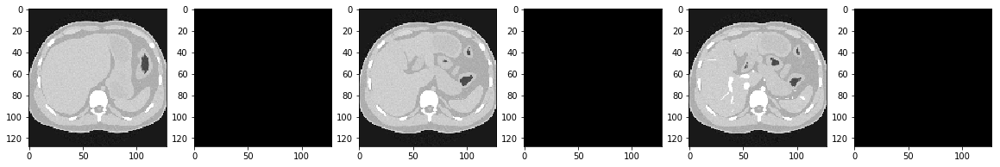

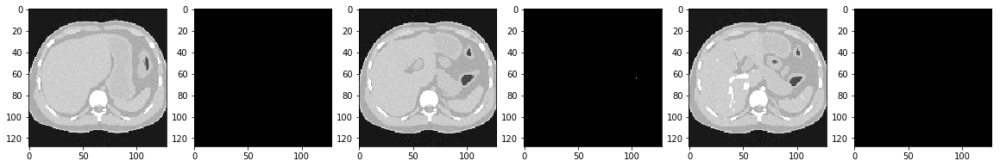

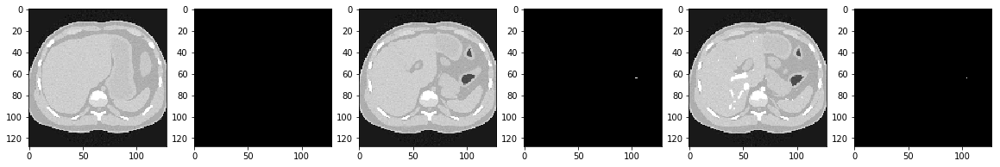

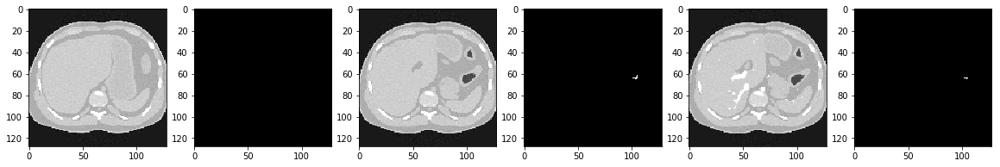

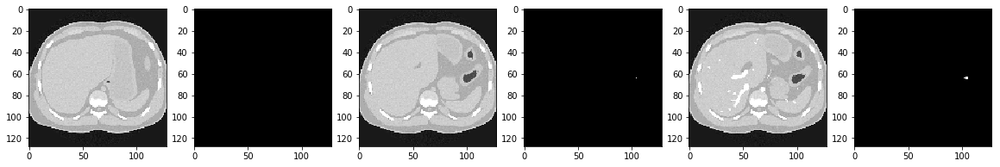

...

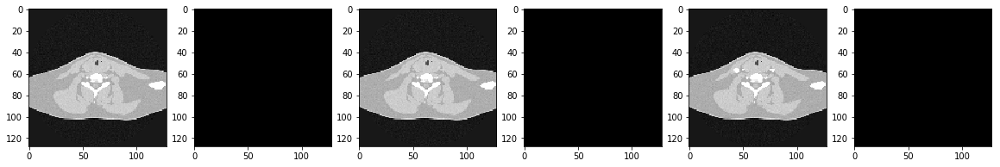

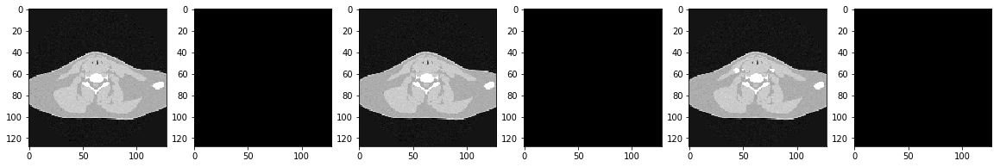

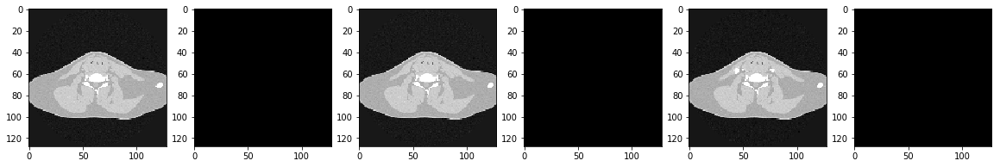

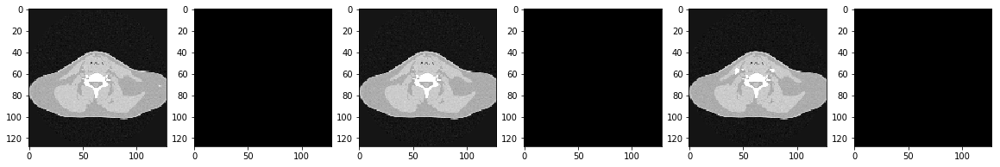

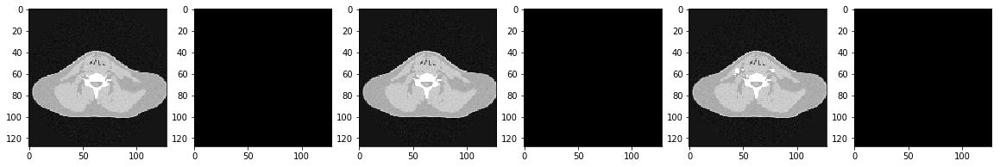

In [19]:
%matplotlib inline
import matplotlib.pyplot as plt
for i in range(0, 285, 2): # 0에서 160까지의 숫자를 10칸 간격으로 추출하겠다는 의미
    plt.figure(figsize=(20, 6))
    plt.subplot(1, 6, 1)
    plt.imshow(x_train1[i,:,:,0],'gray')
    plt.subplot(1, 6, 2)
    plt.imshow(result1[i,:,:,0],'gray')
    plt.subplot(1, 6, 3)
    plt.imshow(x_train2[i,:,:,0],'gray')
    plt.subplot(1, 6, 4)
    plt.imshow(result2[i,:,:,0],'gray')
    plt.subplot(1, 6, 5)
    plt.imshow(x_train3[i,:,:,0],'gray')
    plt.subplot(1, 6, 6)
    plt.imshow(result3[i,:,:,0],'gray')

    plt.show()

## 4.더많은 데이터를 확보하기 위해서 정답레이블이 있는 기존 data와 labeling된 이미지를 함께 사용합니다

In [20]:

mmasks = io.imread('C://lumic_grandchell_dataset//train//train_mask.mhd', plugin='simpleitk')
# print(mmasks.shape)
yo_train = [cv2.resize(mmask, dsize=(128,128),interpolation=cv2.INTER_LANCZOS4) for mmask in mmasks]
yo_train = np.array(yo_train, dtype=np.float32)



for i in range(result1.shape[0]):   
    cv2.imwrite("C:/lumic_grandchell_dataset/x___train/yo_train[{}].png".format(i), yo_train[i])
    cv2.imwrite("C:/lumic_grandchell_dataset/x___train/result1[{}].png".format(i), result1[i])
    cv2.imwrite("C:/lumic_grandchell_dataset/x___train/result2[{}].png".format(i), result2[i])
    cv2.imwrite("C:/lumic_grandchell_dataset/x___train/result3[{}].png".format(i), result3[i])

In [21]:
#원본이미지
x1_imgs = io.imread('C:/lumic_grandchell_dataset/train/020_train_pre_contrast_6mm.mhd', plugin='simpleitk')

x1_train=[]
x1_train = [cv2.resize(x1_img, dsize=(128,128),interpolation=cv2.INTER_LANCZOS4) for x1_img in x1_imgs]
x1_train = np.array(x1_train)



#전처리




x1_train = x1_train.astype('float32')


center = -400
width = 1500

low = center - width / 2
high = center + width / 2


x1_train = (x1_train-low) / (high-low)
x1_train[x1_train < 0.] = 0.
x1_train[x1_train > 1.] = 1.


x1_train_std = np.std(x1_train)
x1_train_mean = np.mean(x1_train)

print(x1_train_std,x1_train_mean)

x1_train -= x1_train_mean
x1_train /= x1_train_std



x1_train = x1_train.reshape(-1,128,128,1)

0.32601342 0.4730365


In [22]:
#4명의 환자 CT_data
CT_file=[]
for i in range(286):
    CT_file.append(x1_train[i])
    CT_file.append(x_train1[i])
    CT_file.append(x_train2[i])
    CT_file.append(x_train3[i])
CT_file = np.array(CT_file)
print(CT_file.shape)

(1144, 128, 128, 1)


In [23]:
#4명의 환자 mask 이미지
yo_train = yo_train.reshape(-1,128,128,1)
Lung_file=[]
for i in range(286):
    Lung_file.append(yo_train[i])
    Lung_file.append(result1[i])
    Lung_file.append(result2[i])
    Lung_file.append(result3[i])

Lung_file = np.array(Lung_file)

print(Lung_file.shape)

(1144, 128, 128, 1)


## 5. 4명의 환자의 CT데이터와 4명의환자 mask이미지입니다.

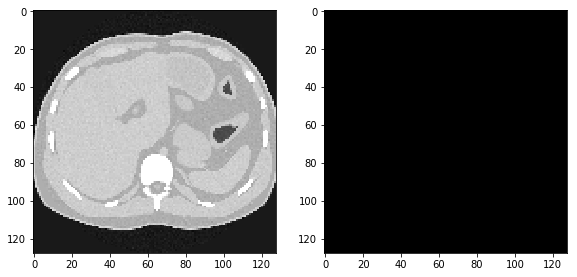

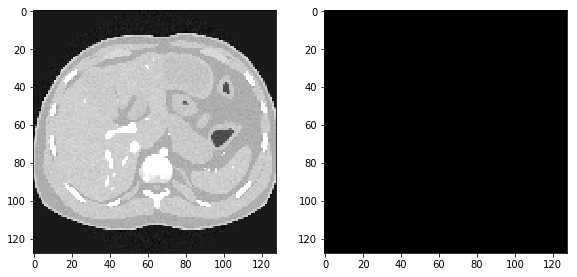

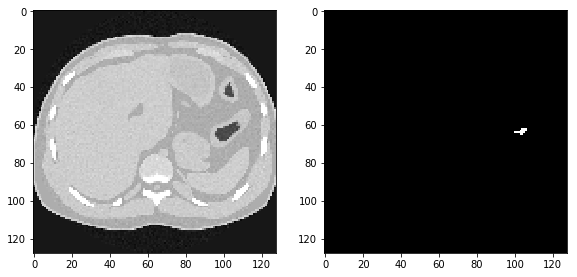

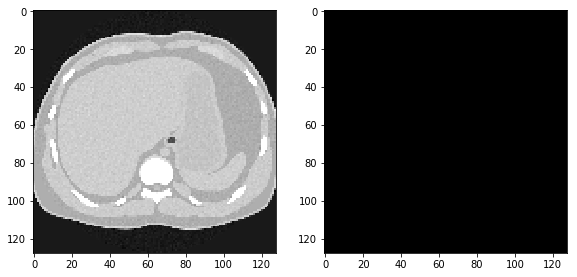

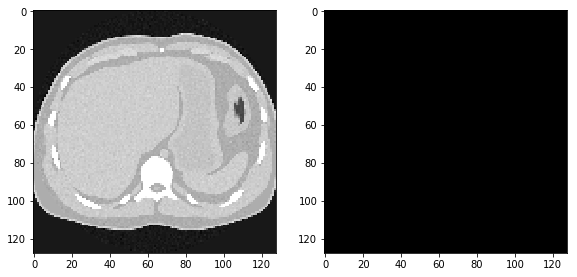

...

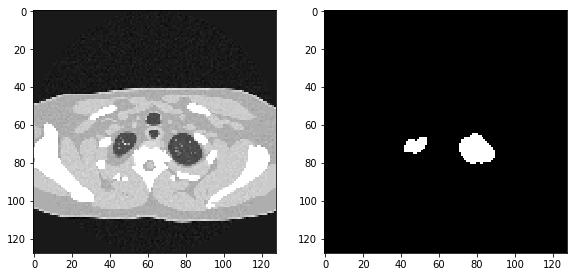

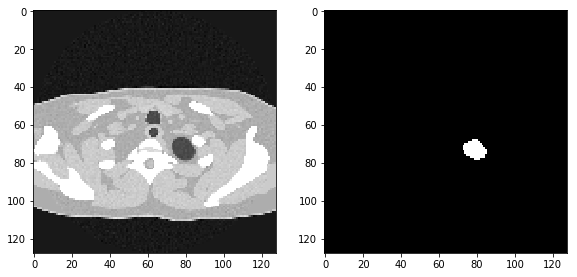

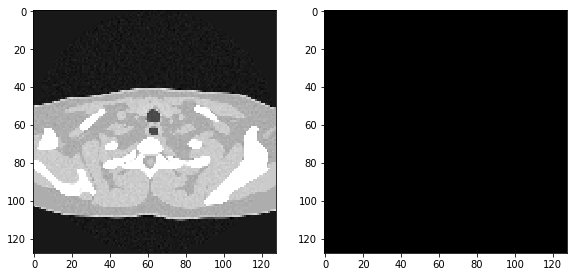

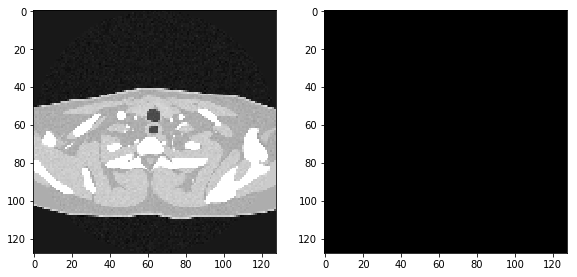

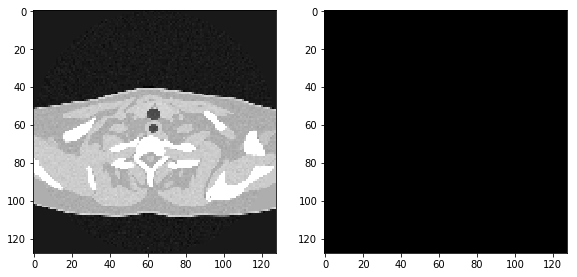

In [24]:
%matplotlib inline
import matplotlib.pyplot as plt
for i in range(0, 1000, 15): # 0에서 160까지의 숫자를 10칸 간격으로 추출하겠다는 의미
    plt.figure(figsize=(20, 6))
    plt.subplot(1, 4, 1)
    plt.imshow(CT_file[i,:,:,0],'gray')
    plt.subplot(1, 4, 2)
    plt.imshow(Lung_file[i,:,:,0],'gray')
    plt.show()

In [25]:
x_test = []
y_test =[]
x_val=[]
y_val=[]


test_imgs = io.imread('C://lumic_grandchell_dataset//test//test_post_contrast.mhd', plugin='simpleitk')
mmasks = io.imread('C://lumic_grandchell_dataset//test//test_mask.mhd', plugin='simpleitk')
x_test = [cv2.resize(test_img, dsize=(128,128),interpolation=cv2.INTER_LANCZOS4) for test_img in test_imgs]
y_test =[cv2.resize(mmask, dsize=(128,128),interpolation=cv2.INTER_LANCZOS4) for mmask in mmasks]


CT_file = np.array(CT_file, dtype=np.float32)
Lung_file = np.array(Lung_file, dtype=np.float32)
x_test=np.array(x_test,dtype=np.float32)
y_test=np.array(y_test,dtype=np.float32)
x_test = x_test.reshape(-1,128,128,1)
y_test = y_test.reshape(-1,128,128,1)
print(CT_file.shape,Lung_file.shape,x_test.shape,y_test.shape)


CT_file,x_val,Lung_file,y_val = train_test_split(CT_file, Lung_file, test_size =0.2)

x_val = np.array(x_val)
y_val = np.array(y_val)


print(CT_file.shape,Lung_file.shape)
print(x_val.shape,y_val.shape)

(1144, 128, 128, 1) (1144, 128, 128, 1) (286, 128, 128, 1) (286, 128, 128, 1)
(915, 128, 128, 1) (915, 128, 128, 1)
(229, 128, 128, 1) (229, 128, 128, 1)


## 6. 전처리 스케일링 해줍니다.

In [26]:
#4명의환자 전처리,스케일링

CT_file = CT_file.astype('float32')
x_test =x_test.astype('float32')
x_val=x_val.astype('float32')


center = -400
width = 1500

low = center - width / 2
high = center + width / 2


CT_file = (CT_file-low) / (high-low)
CT_file[CT_file < 0.] = 0.
CT_file[CT_file > 1.] = 1.

x_val = (x_val-low) / (high-low)
x_val[x_val < 0.] = 0.
x_val[x_val > 1.] = 1.

x_test = (x_test-low) / (high-low)
x_test[x_test < 0.] = 0.
x_test[x_test > 1.] = 1.


CT_file_std = np.std(CT_file)
CT_file_mean = np.mean(CT_file)
test_std = np.std(x_test)
test_mean = np.mean(x_test)
val_std = np.std(x_val)
val_mean = np.mean(x_val)
print(CT_file_mean,CT_file_std,test_mean,test_std,val_std,val_mean)

CT_file -= CT_file_mean
CT_file /= CT_file_std
x_test -= test_mean
x_test /= test_std
x_val -= val_mean
x_val /= val_std




Lung_file[Lung_file < 0.] = 0.
Lung_file[Lung_file > 1.] = 1.

y_val[y_val < 0.] = 0.
y_val[y_val > 1.] = 1.

y_test[y_test < 0.] = 0.
y_test[y_test > 1.] = 1.

0.7666625 0.00066699047 0.4810989 0.33395082 0.00066521787 0.76667964


## 7. segmentation으로 가장 널리 알려진 U-net 모델코드입니다.

In [27]:
#u-net

from keras.models import Model
from keras.layers import *
from keras.optimizers import Adam
from keras.regularizers import l2
from keras.preprocessing.image import ImageDataGenerator
import keras.backend as K
from keras.callbacks import LearningRateScheduler, ModelCheckpoint

input_layer = Input((128,128, 1))
c1 = Conv2D(filters=8, kernel_size=(3,3), activation='relu', padding='same')(input_layer)
l = MaxPool2D(strides=(2,2))(c1)
c2 = Conv2D(filters=16, kernel_size=(3,3), activation='relu', padding='same')(l)
l = MaxPool2D(strides=(2,2))(c2)
c3 = Conv2D(filters=32, kernel_size=(3,3), activation='relu', padding='same')(l)
l = MaxPool2D(strides=(2,2))(c3)
c4 = Conv2D(filters=32, kernel_size=(1,1), activation='relu', padding='same')(l)
l = concatenate([UpSampling2D(size=(2,2))(c4), c3], axis=-1)
l = Conv2D(filters=32, kernel_size=(2,2), activation='relu', padding='same')(l)
l = concatenate([UpSampling2D(size=(2,2))(l), c2], axis=-1)
l = Conv2D(filters=24, kernel_size=(2,2), activation='relu', padding='same')(l)
l = concatenate([UpSampling2D(size=(2,2))(l), c1], axis=-1)
l = Conv2D(filters=16, kernel_size=(2,2), activation='relu', padding='same')(l)
l = Conv2D(filters=64, kernel_size=(1,1), activation='relu')(l)
l = Dropout(0.5)(l)
output_layer = Conv2D(filters=1, kernel_size=(1,1), activation='sigmoid')(l)
                                                         
model = Model(input_layer, output_layer)
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            (None, 128, 128, 1)  0                                            
__________________________________________________________________________________________________
conv2d_10 (Conv2D)              (None, 128, 128, 8)  80          input_2[0][0]                    
__________________________________________________________________________________________________
max_pooling2d_4 (MaxPooling2D)  (None, 64, 64, 8)    0           conv2d_10[0][0]                  
__________________________________________________________________________________________________
conv2d_11 (Conv2D)              (None, 64, 64, 16)   1168        max_pooling2d_4[0][0]            
__________________________________________________________________________________________________
max_poolin

In [28]:
def my_generator2(CT_file, Lung_file, batch_size):
    data_generator = ImageDataGenerator(
            width_shift_range=0.1,
            height_shift_range=0.1,
            rotation_range=10,
            zoom_range=0.1).flow(CT_file, CT_file, batch_size, seed=SEED)
    mask_generator = ImageDataGenerator(
            width_shift_range=0.1,
            height_shift_range=0.1,
            rotation_range=10,
            zoom_range=0.1).flow(Lung_file, Lung_file, batch_size, seed=SEED)
    while True:
        x_batch, _ = data_generator.next()
        y_batch, _ = mask_generator.next()
        yield x_batch, y_batch

In [29]:
CT_file = CT_file.reshape(-1,128,128,1)
Lung_file = Lung_file.reshape(-1,128,128,1)

x_test = x_test.reshape(-1,128,128,1)
y_test = y_test.reshape(-1,128,128,1)
x_val = x_val.reshape(-1,128,128,1)
y_val  = y_val.reshape(-1,128,128,1)

## 8.이미지 세분화의 정확도를 측정하기 위해 사용한 dice_coef 함수입니다

In [30]:
def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + K.epsilon()) / (K.sum(y_true_f) + K.sum(y_pred_f) + K.epsilon())

In [31]:
image_batch, mask_batch = next(my_generator2(CT_file, Lung_file, 3))

In [32]:
# 픽셀값 0과 1을 구분시키기위해 binary_crossentropy를 사용합니다.
model.compile(optimizer=Adam(2e-4), loss='binary_crossentropy', metrics=[dice_coef])

In [33]:

weight_saver = ModelCheckpoint('lung100.h', monitor='val_dice_coef', 
                                              save_best_only=True, save_weights_only=True)
annealer = LearningRateScheduler(lambda x: 1e-3 * 0.8 ** x)

In [34]:
#모댈을 실행시켜줍니다.
hist = model.fit_generator(my_generator2(CT_file, Lung_file, 1),
                           steps_per_epoch = 200,
                           validation_data = (x_val, y_val),
                           epochs=10, verbose=2,
                           callbacks = [weight_saver, annealer])

Epoch 1/10
 - 27s - loss: 0.1980 - dice_coef: 0.2796 - val_loss: 0.0835 - val_dice_coef: 0.4784
Epoch 2/10
 - 25s - loss: 0.0809 - dice_coef: 0.4731 - val_loss: 0.0672 - val_dice_coef: 0.5404
Epoch 3/10
 - 26s - loss: 0.0658 - dice_coef: 0.5281 - val_loss: 0.0557 - val_dice_coef: 0.5815
Epoch 4/10
 - 26s - loss: 0.0527 - dice_coef: 0.5404 - val_loss: 0.0493 - val_dice_coef: 0.6035
Epoch 5/10
 - 26s - loss: 0.0529 - dice_coef: 0.6216 - val_loss: 0.0401 - val_dice_coef: 0.6337
Epoch 6/10
 - 27s - loss: 0.0468 - dice_coef: 0.6499 - val_loss: 0.0338 - val_dice_coef: 0.6575
Epoch 7/10
 - 29s - loss: 0.0348 - dice_coef: 0.5752 - val_loss: 0.0292 - val_dice_coef: 0.6752
Epoch 8/10
 - 29s - loss: 0.0336 - dice_coef: 0.5907 - val_loss: 0.0294 - val_dice_coef: 0.6722
Epoch 9/10
 - 31s - loss: 0.0329 - dice_coef: 0.5820 - val_loss: 0.0266 - val_dice_coef: 0.6838
Epoch 10/10
 - 30s - loss: 0.0321 - dice_coef: 0.6075 - val_loss: 0.0245 - val_dice_coef: 0.6907


In [35]:
resultA = model.predict(CT_file)

resultA[resultA < 0.5] = 0.
resultA[resultA >= 0.5] = 1.

In [36]:
x = []
for i in range(286):   
    resultmask = cv2.imread("C:/lumic_grandchell_dataset/resultAAnpy/resultAA[{}].png".format(i))
    x.append(resultmask)
print(x[0].shape)

(128, 128, 3)


In [37]:
y = []
for i in range(286):   
    lungfilemask = cv2.imread("C:/lumic_grandchell_dataset/lungfile/Lung_file[{}].png".format(i))
    y.append(lungfilemask)
print(y[0].shape)

(128, 128, 3)


## 1번째 실제정답레이블(모델로인한 3명의가정답 레이블+정답레이블) 과 예측레이블의 차이를 시각화로 나타내기위해 실제정답레이블은 빨간색, 예측레이블을 파란색으로 나타냈습니다.

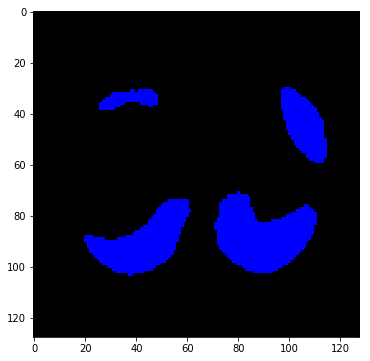

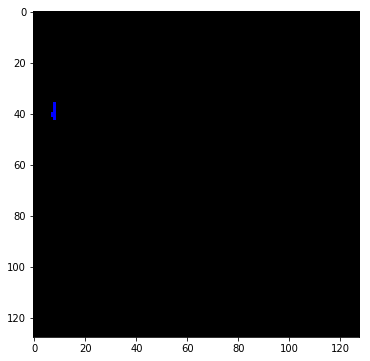

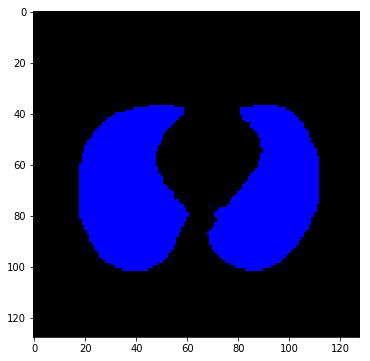

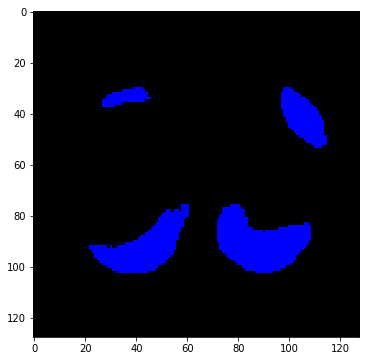

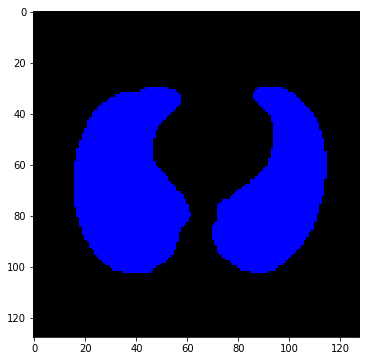

...

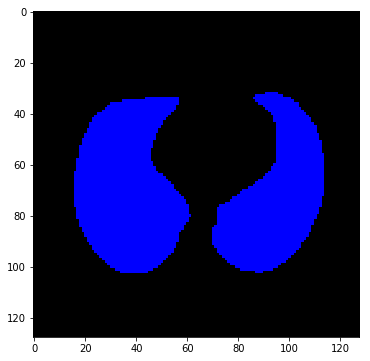

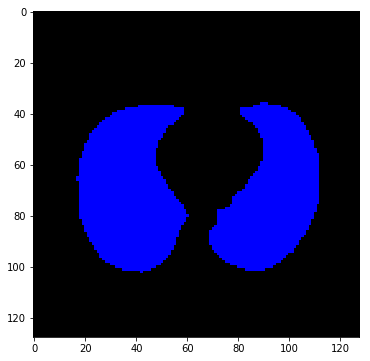

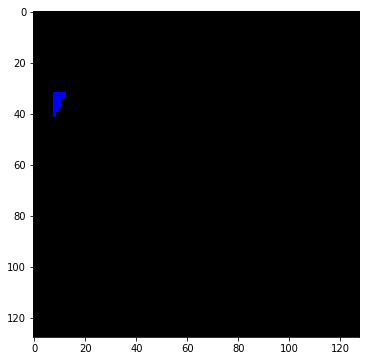

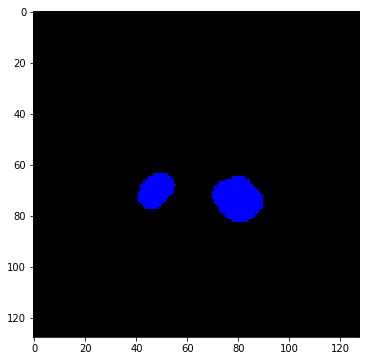

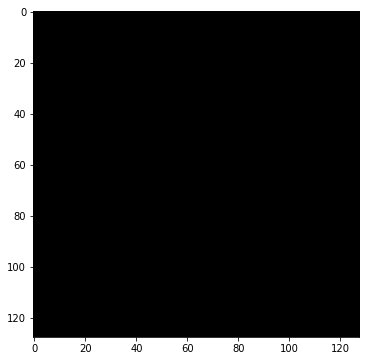

In [38]:
for k in range(286):
    for i in range(128):
        for j in range(128):
            pixel = x[k][i][j]
            if(pixel[0] == 1 and pixel[1] == 1 and pixel[2] == 1):#흰색이면
                pixel[0] = 0    #R
                pixel[1] = 0    #G
                pixel[2] = 255 #B

                
import matplotlib.pyplot as plt
for i in range(0, 286, 2): # 0에서 160까지의 숫자를 10칸 간격으로 추출하겠다는 의미
    plt.figure(figsize=(20, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(x[i])
 
    plt.show()

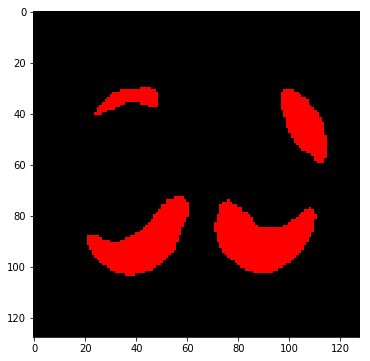

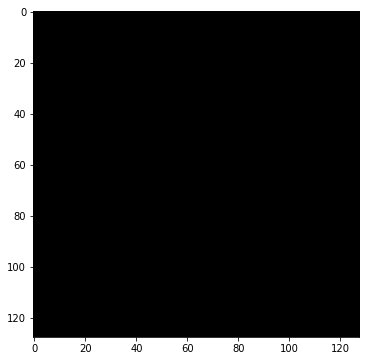

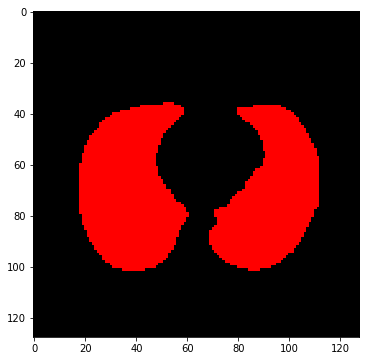

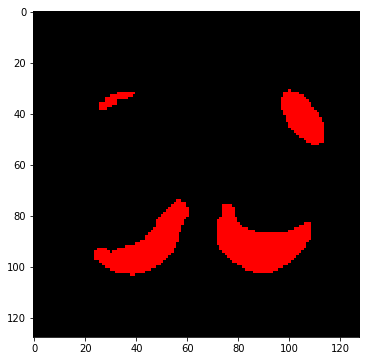

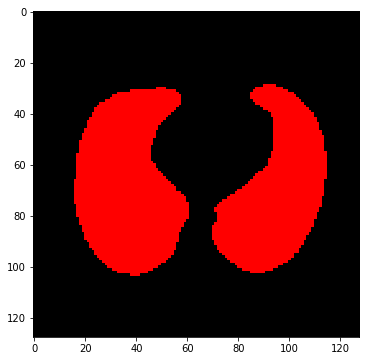

...

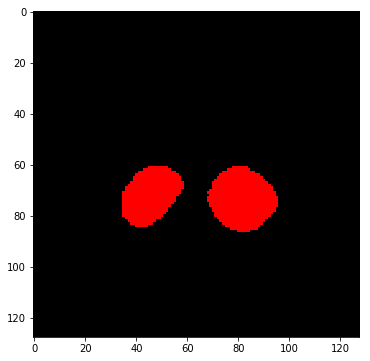

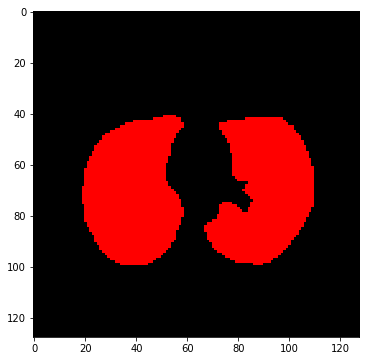

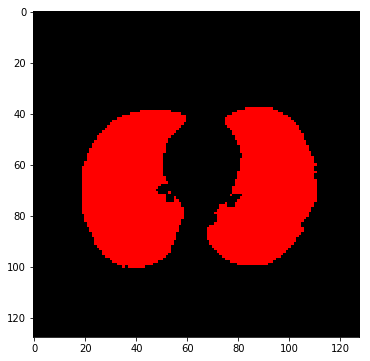

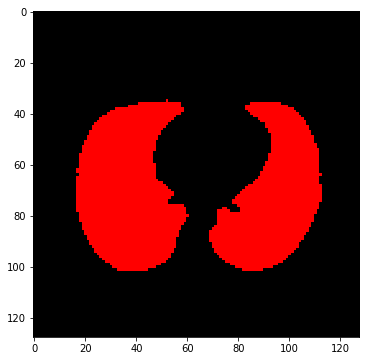

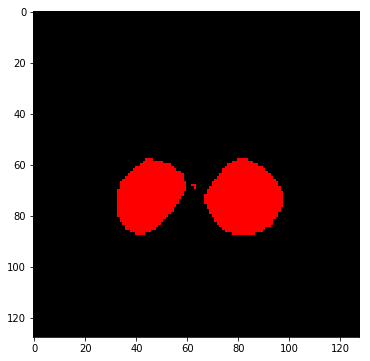

In [39]:
for k in range(286):
    for i in range(128):
        for j in range(128):
            pixel = y[k][i][j]
            if(pixel[0] == 1 and pixel[1] == 1 and pixel[2] == 1):#흰색이면
                pixel[0] = 255    #R
                pixel[1] = 0    #G
                pixel[2] = 0 #B

                
import matplotlib.pyplot as plt
for i in range(0, 100, 2): # 0에서 160까지의 숫자를 10칸 간격으로 추출하겠다는 의미
    plt.figure(figsize=(20, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(y[i])
 
    plt.show()

c:\users\juhee\desktop\project\chainsaw_classification\vir_chainsaw\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


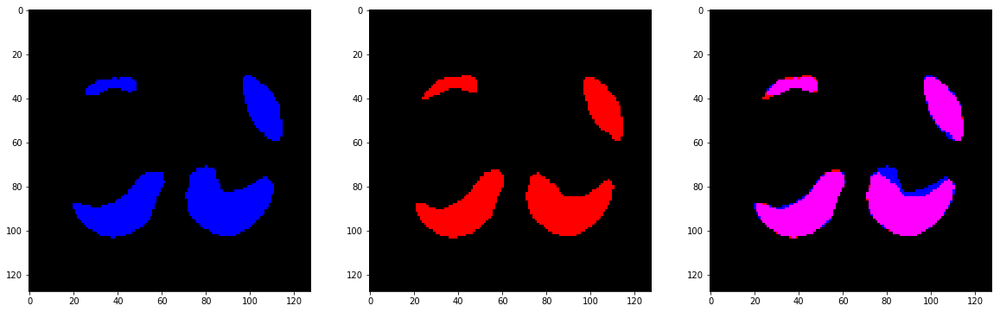

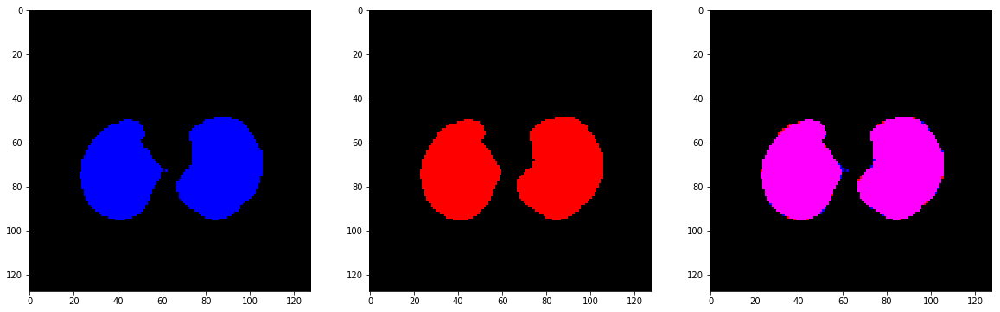

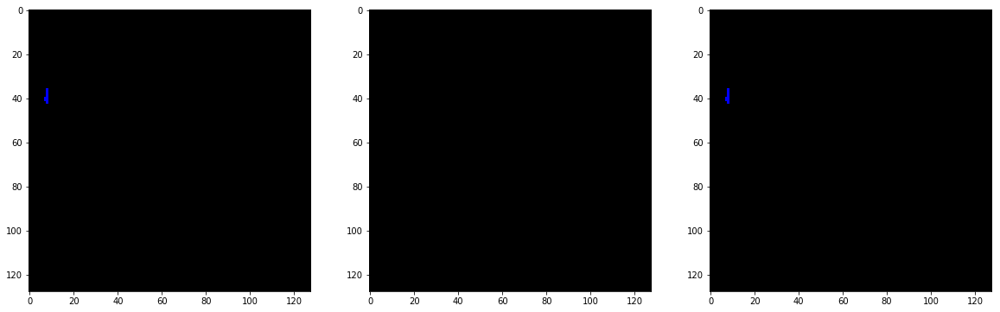

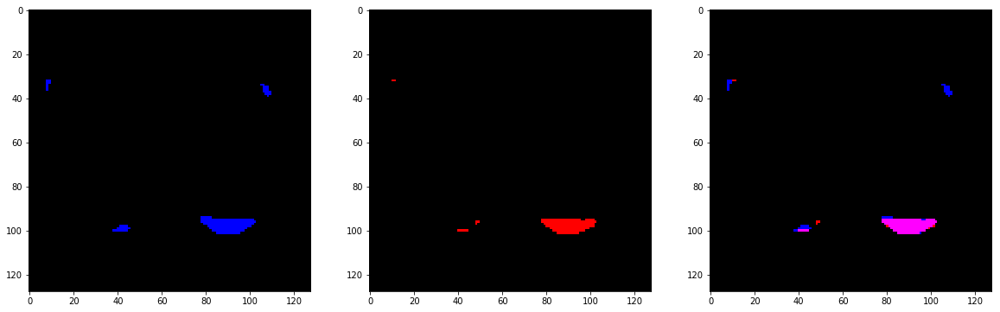

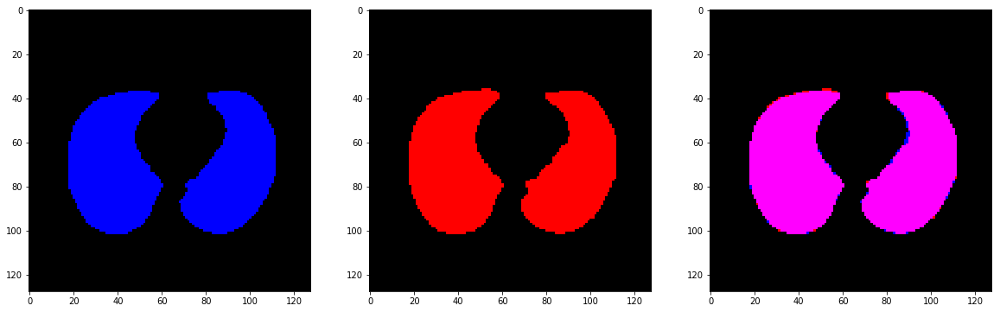

...

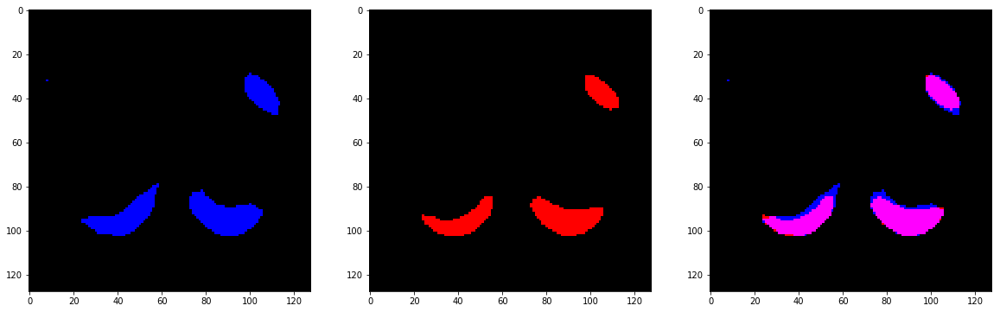

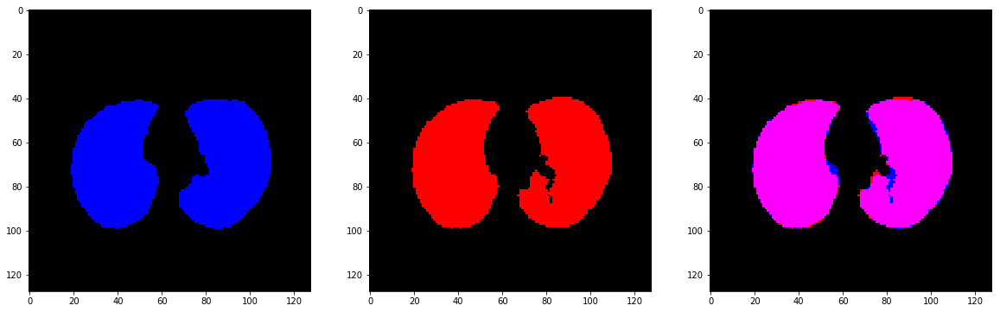

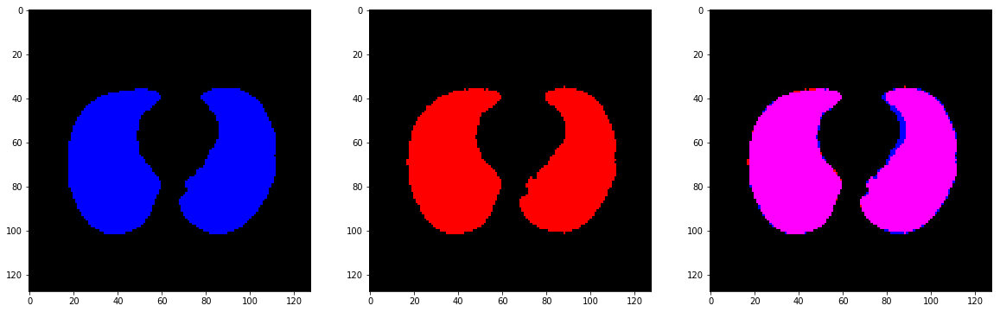

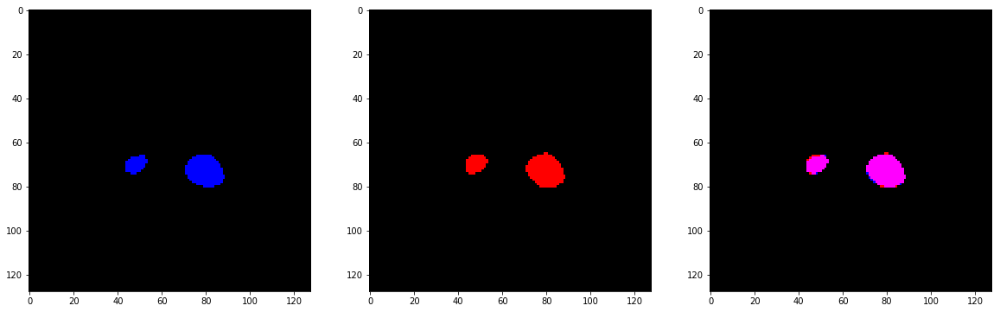

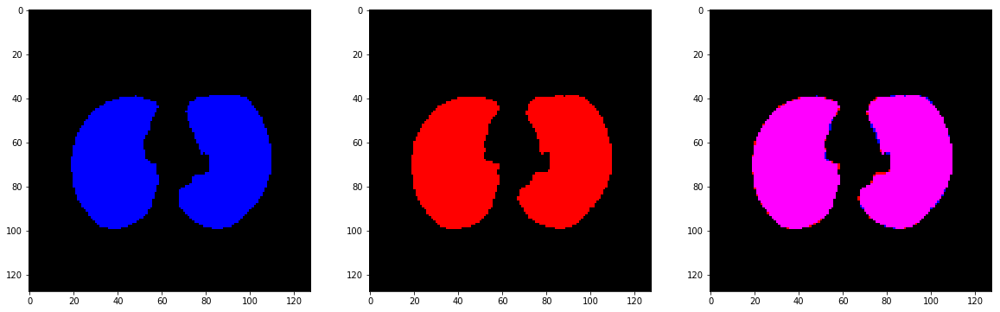

In [40]:
for i in range(200):   
    plt.figure(figsize=(20, 6))
    plt.subplot(1, 3, 1)
    plt.imshow(x[i])
    plt.subplot(1, 3, 2)
    plt.imshow(y[i])
    plt.subplot(1, 3, 3)
    plt.imshow(x[i]+y[i])
    
